# Generic Unet for Fiji 

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
from scipy.optimize import curve_fit
import skimage.external.tifffile
from PIL import Image
import random
import utils
import shutil
import os

In [2]:
data='/n/core/micro/asa/fgm/smc/20190919_Screen/DeepLearn/Training/'

In [3]:
base_scaler=32

In [4]:
x_dim=128
y_dim=128
channels=2

mean=153.0
std=100.0

# Get data

Load data from file

In [5]:
both=skimage.external.tifffile.imread(data+'Training_windowed_trimmed.tif')
both=np.swapaxes(np.swapaxes(both,2,3), 3,4)

x_dim=both.shape[1]
y_dim=both.shape[2]
channels=both.shape[3]-1

In [6]:
train_data=both[:,:,:,:,[0]]
train_truth=both[:,:,:,:,[1]]

both=0

#non_zeros=np.where(train_data!=0)
#mean=np.mean(train_data)
#std=np.std(train_data)


train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1
train_truth[np.where(train_truth<0)]=0



In [7]:
validation=skimage.external.tifffile.imread(data+'Validation.tif')
validation=np.swapaxes(np.swapaxes(validation,2,3), 3,4)

validation_data=validation[:,:,:,:,[0]]
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,:,[1]]
validation_truth[np.where(validation_truth>0.1)]=1
validation_truth[np.where(validation_truth<0)]=0

In [8]:
print([mean, std])

[153.0, 100.0]


# Design network

Define a function to create a convolutional layer, including conv, relu, maxpool, that can be called multiple times

In [5]:
tf.reset_default_graph()
#Input and output
x=tf.placeholder(dtype=tf.float32, shape=[None, 8, 128,128,1])
y=tf.placeholder(dtype=tf.float32, shape=[None, 8, 128,128,1])

lr=tf.placeholder(dtype=tf.float32, shape=[], name='learning_rate')
dr=tf.placeholder(dtype=tf.float32, shape=[], name='dropout_rate')

regularizer = tf.contrib.layers.l2_regularizer(scale=0.1)

xr=x
yr=y

base_scaler=32

#Going down
A1=utils.leaky_relu(tf.layers.conv3d(xr, base_scaler, [3,5,5], padding='SAME', kernel_regularizer=regularizer))
A2=utils.leaky_relu(tf.layers.conv3d(A1, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

B0=tf.nn.max_pool3d(A2, ksize=[1,1,2,2,1], strides=[1,1,2,2,1], padding='SAME')
B1=utils.leaky_relu(tf.layers.conv3d(B0, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
B2=utils.leaky_relu(tf.layers.conv3d(B1, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

C0=tf.nn.max_pool3d(B2, ksize=[1,2,2,2,1], strides=[1,2,2,2,1], padding='SAME')
C1=utils.leaky_relu(tf.layers.conv3d(C0, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
C2=utils.leaky_relu(tf.layers.conv3d(C1, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

D0=tf.nn.max_pool3d(C2, ksize=[1,1,2,2,1], strides=[1,1,2,2,1], padding='SAME')
D1=utils.leaky_relu(tf.layers.conv3d(D0, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
D2=utils.leaky_relu(tf.layers.conv3d(D1, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

E0=tf.nn.max_pool3d(D2, ksize=[1,2,2,2,1], strides=[1,2,2,2,1], padding='SAME')
E1=utils.leaky_relu(tf.layers.conv3d(E0, 16*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
E2=utils.leaky_relu(tf.layers.conv3d(E1, 16*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

#Coming up
DD0=tf.layers.conv3d_transpose(E2, 8*base_scaler, kernel_size=[3,3,3], strides=[2,2, 2], padding='SAME')
DD1=tf.concat(axis=4, values=[DD0,D2])
DD2=utils.leaky_relu(tf.layers.conv3d(DD1, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
DD3=utils.leaky_relu(tf.layers.conv3d(DD2, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

CC0=tf.layers.conv3d_transpose(DD3, 4*base_scaler, kernel_size=[3,3,3], strides=[1,2, 2], padding='SAME')
CC1=tf.concat(axis=4, values=[CC0,C2])
CC2=utils.leaky_relu(tf.layers.conv3d(CC1, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
CC3=utils.leaky_relu(tf.layers.conv3d(CC2, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

BB0=tf.layers.conv3d_transpose(CC3, 2*base_scaler, kernel_size=[3,3,3], strides=[2,2, 2], padding='SAME')
#BB0=tf.contrib.layers.conv2d_transpose(C2, 2*base_scaler, kernel_size=[3,3], stride=[2, 2], padding='SAME')
BB1=tf.concat(axis=4, values=[BB0,B2])
BB2=utils.leaky_relu(tf.layers.conv3d(BB1, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
BB3=utils.leaky_relu(tf.layers.conv3d(BB2, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

AA0=tf.layers.conv3d_transpose(BB3, base_scaler, kernel_size=[3,3,3], strides=[1,2, 2], padding='SAME')
AA1=tf.concat(axis=4, values=[AA0,A2])
AA2=utils.leaky_relu(tf.layers.conv3d(AA1, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
AA3=utils.leaky_relu(tf.layers.conv3d(AA2, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

logits=utils.leaky_relu(tf.layers.conv3d(AA3, 1, [1,1,1], padding='SAME', kernel_regularizer=regularizer))
probs=tf.tanh(logits, name='probabilities')

diff=tf.subtract(probs, yr)
LSQ=tf.multiply(diff,diff)
loss=1*tf.reduce_mean(LSQ[:,:,:,:,0])#+0.1*tf.reduce_mean(LSQ[:,:,:,:,1])+5*tf.reduce_mean(LSQ[:,:,:,:,2])
#Added this to make the outlines more potent in error function
#OutError, MaskError=tf.split(LSQ, [1,1], 3)
#loss=1*tf.reduce_mean(OutError)+0.1*tf.reduce_mean(MaskError)
l2_loss = tf.losses.get_regularization_loss()
#loss=loss+l2_loss/1000

train_op=tf.train.AdamOptimizer(learning_rate=lr, name='trainer').minimize(loss)

tf.summary.scalar('loss', loss)
#tf.summary.image('input', x, 10)
#tf.summary.image('standard', y, 10)
#tf.summary.image('processed', probs, 10)


merge = tf.summary.merge_all()

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.

Instructions for updating:
Use `tf.keras.layers.Conv3D` instead.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Use `tf.keras.layers.Conv3DTranspose` instead.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


# Training

0
Training loss:  0.0047500427
(20, 8, 128, 128, 1)
Validation loss:  1.0174474


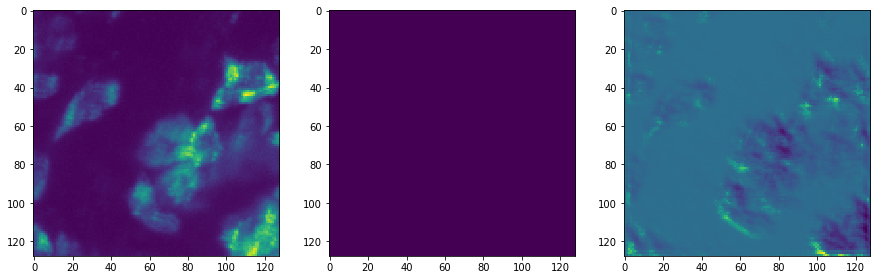

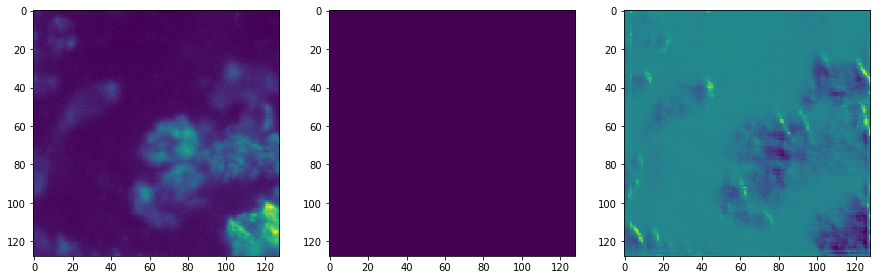

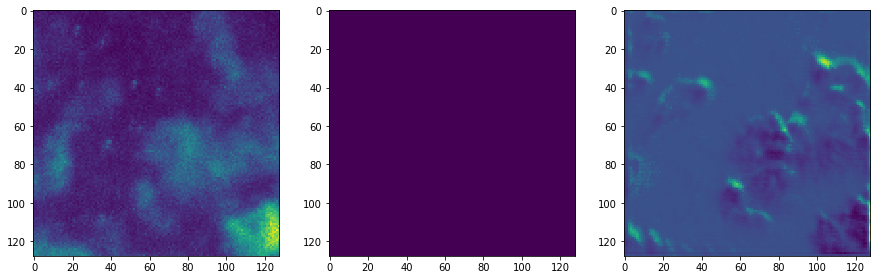

100
Training loss:  0.0024869873
(20, 8, 128, 128, 1)
Validation loss:  0.99210614


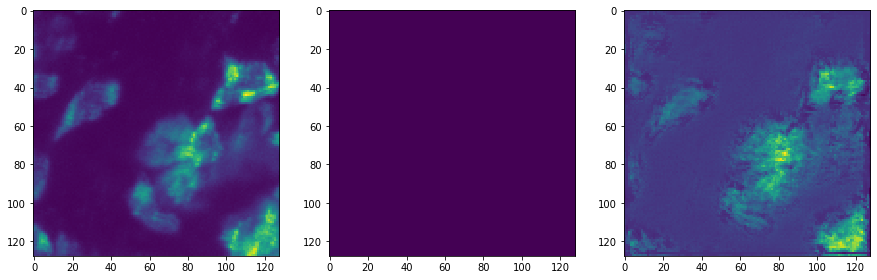

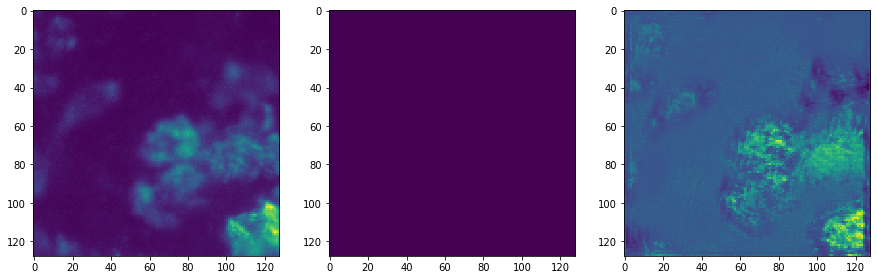

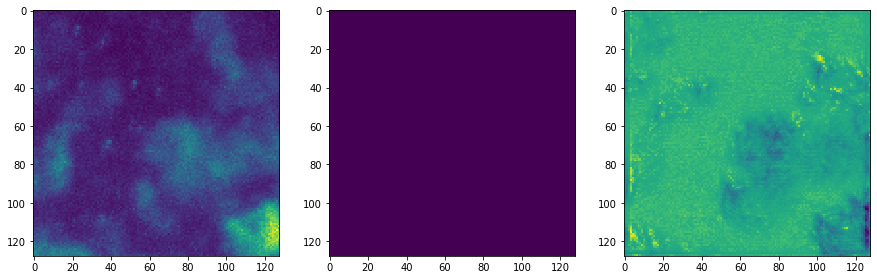

200
Training loss:  0.0024759232
(20, 8, 128, 128, 1)
Validation loss:  0.985347


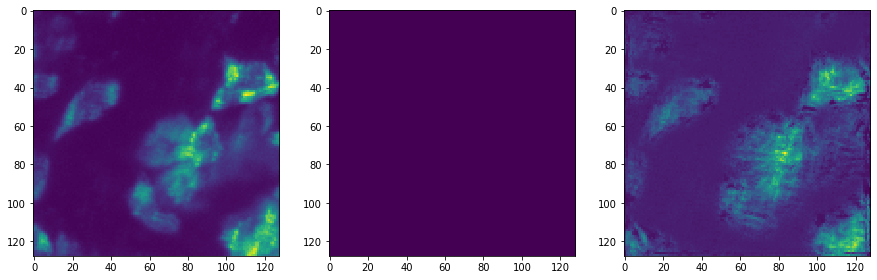

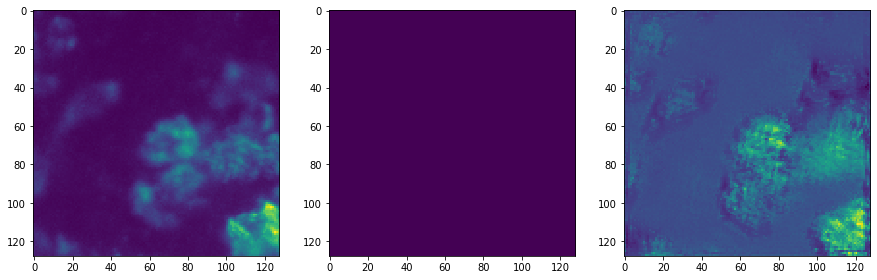

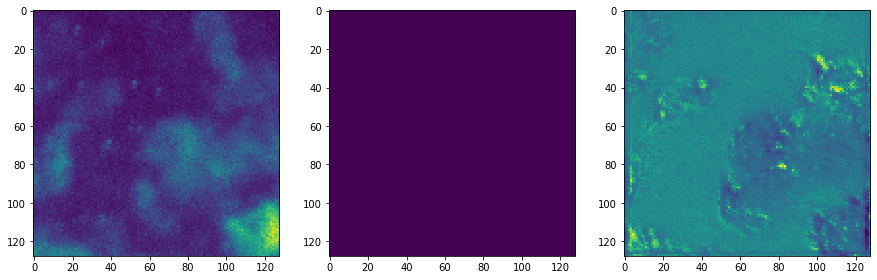

300
Training loss:  0.002626151
(20, 8, 128, 128, 1)
Validation loss:  0.9875469


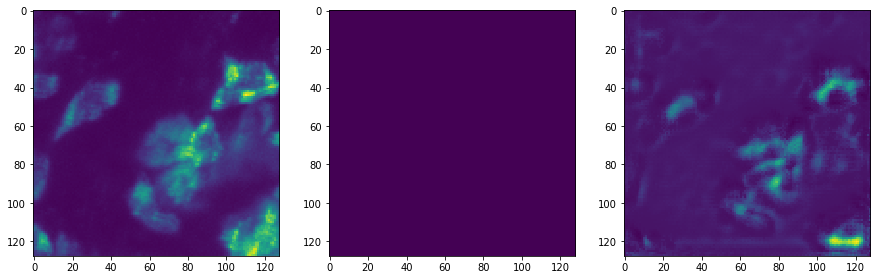

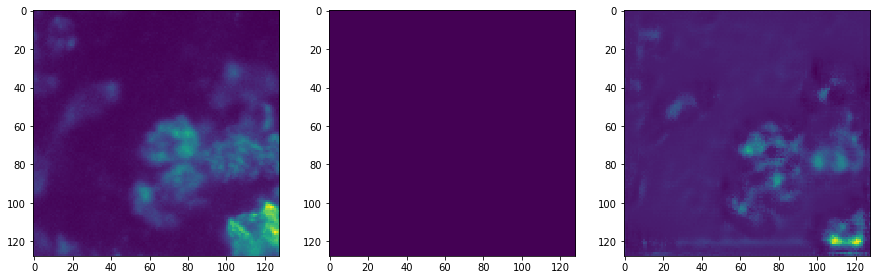

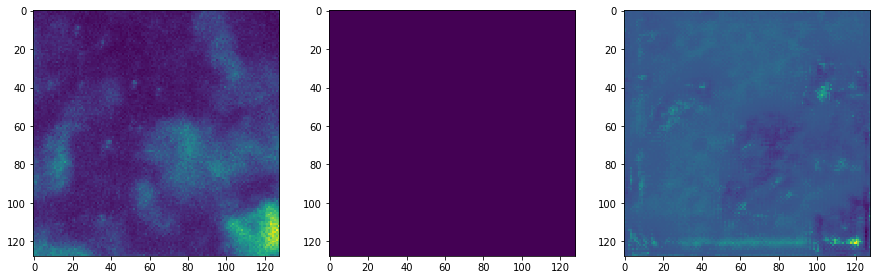

400
Training loss:  0.002546178
(20, 8, 128, 128, 1)
Validation loss:  0.98485327


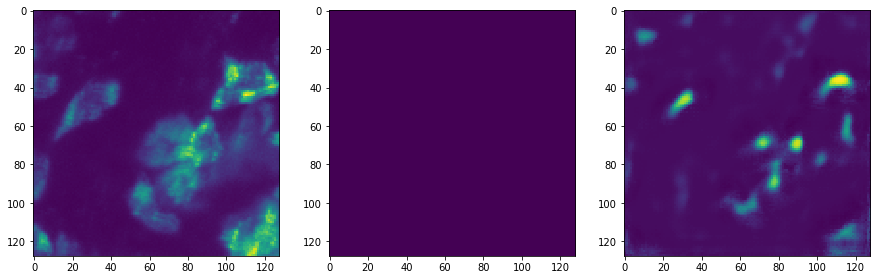

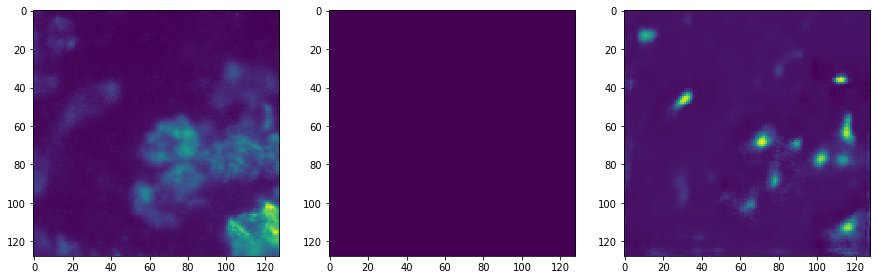

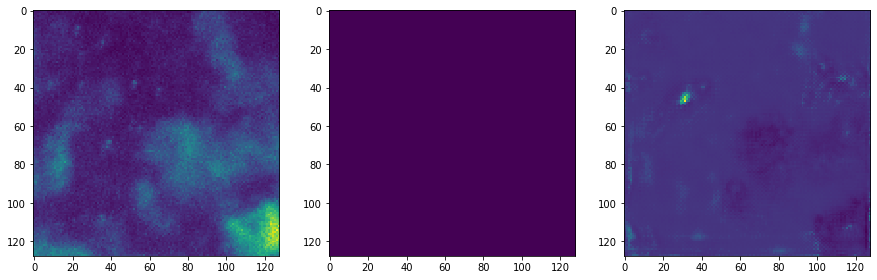

500
Training loss:  0.0018035073
(20, 8, 128, 128, 1)
Validation loss:  0.9884423


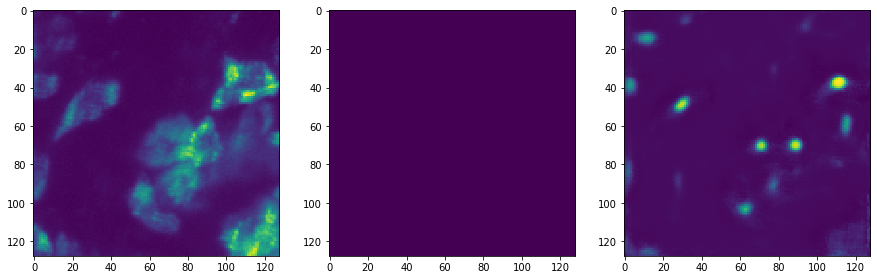

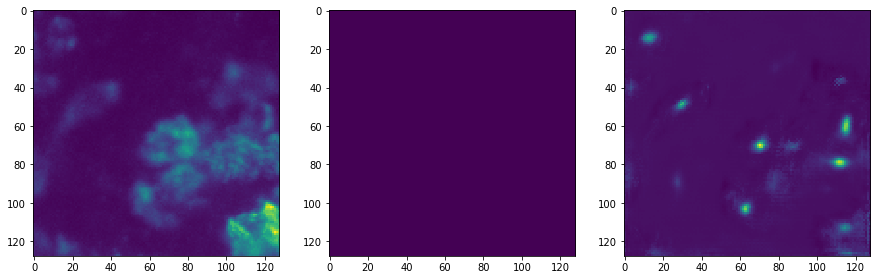

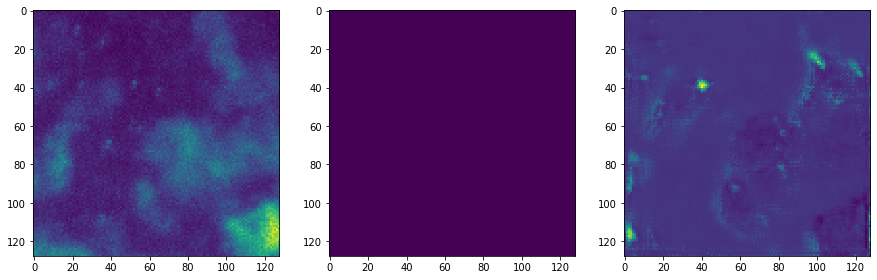

600
Training loss:  0.003370333
(20, 8, 128, 128, 1)
Validation loss:  0.98934317


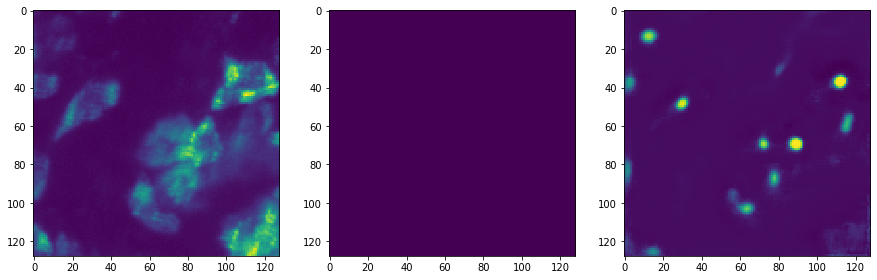

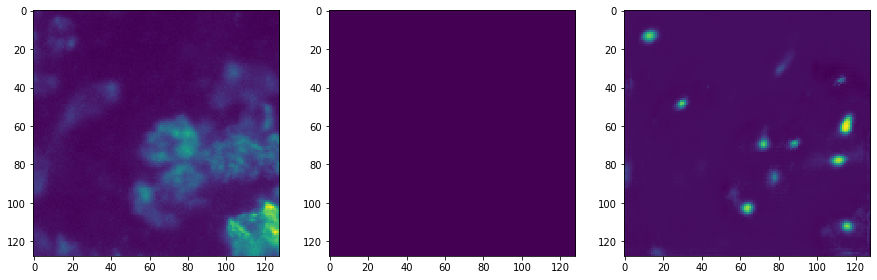

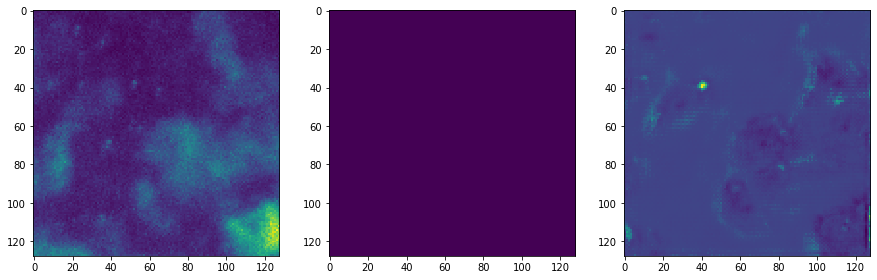

700
Training loss:  0.0010877886
(20, 8, 128, 128, 1)
Validation loss:  0.99225366


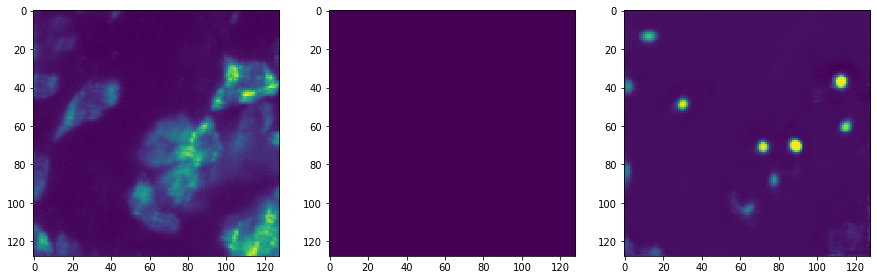

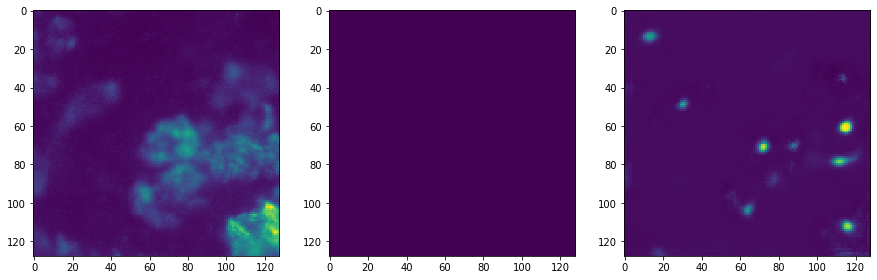

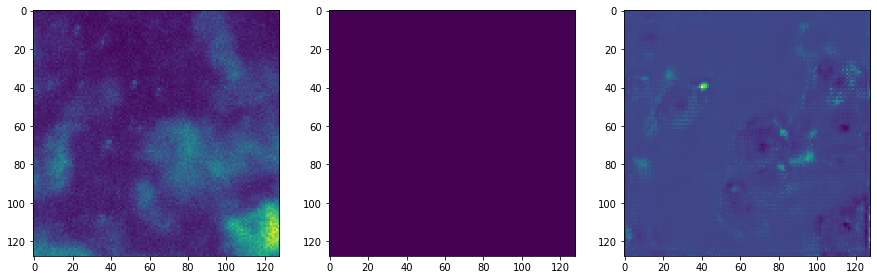

800
Training loss:  0.0015080718
(20, 8, 128, 128, 1)
Validation loss:  0.99299526


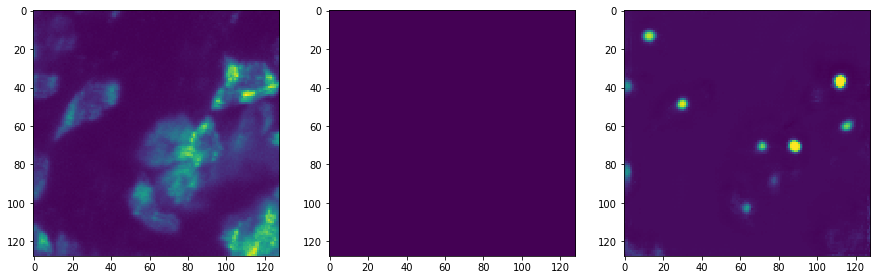

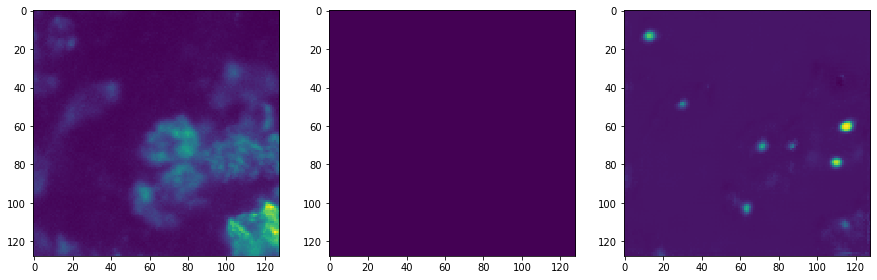

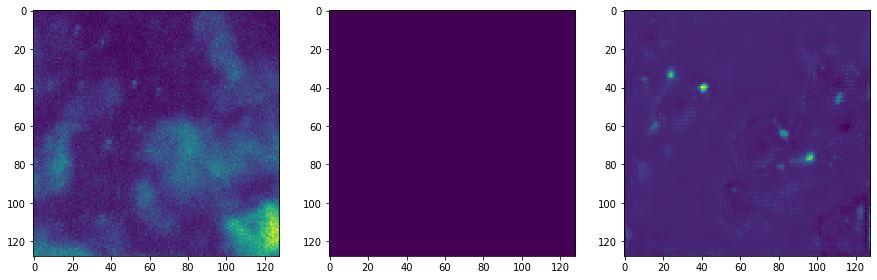

900
Training loss:  0.001059951
(20, 8, 128, 128, 1)
Validation loss:  0.99285996


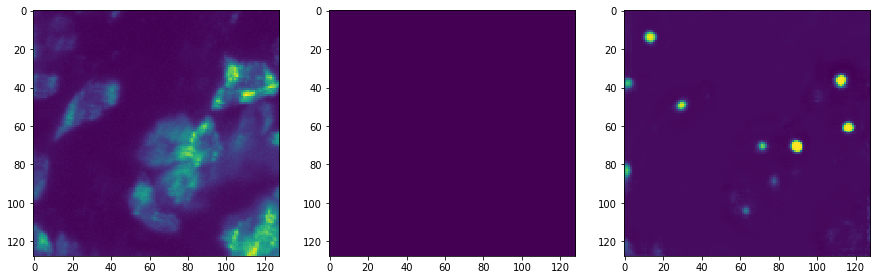

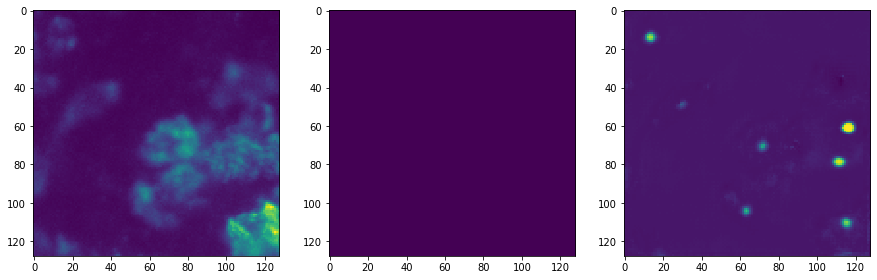

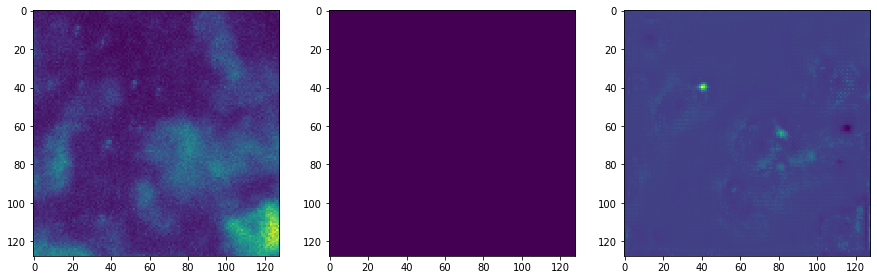

KeyboardInterrupt: 

In [11]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
sess=tf.Session()
sess.run(tf.global_variables_initializer())
saver = tf.train.Saver(max_to_keep=50)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.000195, 0.0001, 0.00002, 0.00001]
learning_rate_steps=[500,2500, 3200, 6000]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[20])
        cur_train=train_data[idx,:,:,:]+0*np.random.uniform(-0.03, 0.03, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,20, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses=sess.run([merge, probs, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[0,ti*2+2,:,:,0], sub_validation_truth[0,ti*2+2,:,:,0], results[0,ti*2+2,:,:,0])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
            outputs=np.zeros([results.shape[0], 8, 2, 128, 128])
            outputs[:,:,0,:,:]=sub_validation_data[:,:,:,:,0]
            outputs[:,:,1,:,:]=results[:,:,:,:,0]
            skimage.external.tifffile.imsave(data+'NewModels/Model_'+str(i).zfill(4)+'.tif', outputs.astype('float32'), imagej=True)
    current_step=lrs

In [21]:
tf.train.write_graph(sess.graph_def, 'Data/NewModels/', 'saved_3100.pb', as_text=False)#1800

'Data/NewModels/saved_3100.pb'

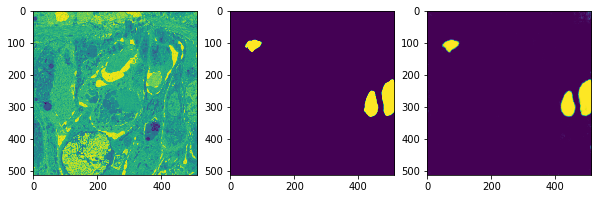

In [31]:
idx=np.random.choice(validation_data.shape[0], replace=False, size=[25])
cur_train=train_data[idx,:,:,:]
cur_truth=train_truth[idx,:,:]
results, losses=sess.run([probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})

ids=4
utils.plot_3x1(cur_train[ids,:,:,0], cur_truth[ids,:,:,0], results[ids,:,:,0])

# Process new datafiles using trained network

Load the network that works best

In [6]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

data_model='/n/core/micro/asa/fgm/smc/20190919_Screen/DeepLearn/Training/v3'+'/Model'+str(2100)
saver.restore(sess,data_model)

Instructions for updating:
Use standard file APIs to check for files with this prefix.
INFO:tensorflow:Restoring parameters from /n/core/micro/asa/fgm/smc/20190919_Screen/DeepLearn/Training/v3/Model2100


Function for processing a file

In [7]:
def process_file(sess, file_path, save_dir):
    file_data=skimage.external.tifffile.imread(file_path)
    #if (len(file_data.shape)==4):
    file_data=np.reshape(file_data, [file_data.shape[0], 8, 128, 128, 1])
    #else:
    #file_data=np.swapaxes(np.swapaxes(file_data,2,3), 3,4)
    inference_data=file_data
    
    #true_test2_data=true_test2_data/np.std(true_test2_data)*0.02
    #true_test2_data=true_test2_data-np.mean(true_test2_data)+0.55
    #v1true_test2_data=(true_test2_data-.578)/.138+0.5
    inference_data=(inference_data-mean)/std+0.5

    channels=inference_data.shape[4]
    num_images=inference_data.shape[0]
    output=np.zeros([num_images,8,128,128,2])
    toutput=np.zeros([num_images,8,128,128])
    process_batch_size=30
    print('Starting')
    for t in range(0,num_images,process_batch_size):
        endrng=np.min((t+process_batch_size,num_images))
        #inference_batch_data=inference_data[t:(t+process_batch_size), :,:,:,:]
        output[t:(t+process_batch_size),:,:,:,1]=sess.run(probs, feed_dict={x:inference_data[t:(t+process_batch_size), :,:,:,:]})[:,:,:,:,0]
        #output[t:(t+process_batch_size),:,:,:,0]=inference_batch_data[:,:,:,:,0]
        #output[t:(t+process_batch_size),:,:,:,1]=results[:,:,:,:,0]
        if (t%400==0):
            print(t)
    print('Done')
    inference_data=0
    output[:,:,:,:,0]=file_data[:,:,:,:,0]
    output=np.swapaxes(np.swapaxes(output,4,3),3,2)
    np.place(output, output<0, 0)
    file_name=file_path.split('/')[-1]
    print(output.dtype)
    skimage.external.tifffile.imsave(save_dir+file_name, output.astype('float32'), imagej=True)
    print('Written')
    return output


In [17]:
output=process_file(sess, '/n/smc/Input/20190814_3PO_IMARE-94149_Screen/20190814_192724_711/'+'Plate000_Well1_Object1.tifpt0.tif', data+'Output/')

Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64


FileNotFoundError: [Errno 2] No such file or directory: '/n/projects/smc/public/SMC/DLSpeedTest/Output/Plate000_Well1_Object1.tifpt0.tif'

In [22]:
#test=process_file(sess, data+'/Input/Plate007_Well2_Object4.tif', data+'/Output/')

In [8]:
import glob
#for f in glob.glob(data+'/Input/*.tif'):
#    output=process_file(sess, f, data+'/Output/')
#for f in glob.glob('/n/smc/Input/*/*/*.tif'):
for f in glob.glob('/n/smc/Input/20190814_3PO_IMARE-94149_Screen/*/*.tif'):    
    outfolder='/n/smc/Output/'+f.split('/')[4]+'/'+f.split('/')[5]+'/'
    #print(outfolder)
    output=process_file(sess, f, outfolder)

Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64


/scratch/smc/anaconda3/lib/python3.7/site-packages/skimage/external/tifffile/tifffile.py:1093: UserWarning: truncating ImageJ file
  warnings.warn("truncating ImageJ file")


Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
Done
float64
Written
Starting
0
1200
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Startin

10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
fl

14400
15600
Done
float64
Written
Starting
0
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
Done
float64
Written
Starting


Starting
0
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
Done
float64
Written
Starting
0
1200
Done
float64
Written
Starting
0
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
Done
float64
Written
Starting
0
1200
2400
3600
4800
600

Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
Done
float64
Written
Start

Starting
0
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
Done
float64
Written
Starting
0
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
Done
float64
Written
Starting
0
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6

1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
120

6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written
Starting
0
1200
2400
3600
4800
6000
7200
8400
9600
10800
12000
13200
14400
15600
Done
float64
Written


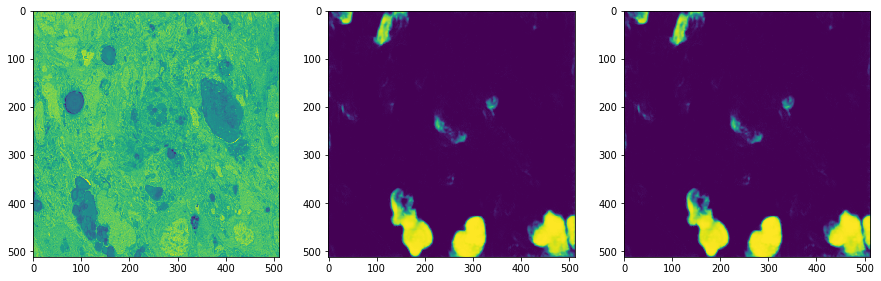

In [24]:
ids=4
utils.plot_3x1(output[ids,0,:,:], output[ids,1,:,:], output[ids,1,:,:])

# Retrain using new data and best old model

In [49]:
if os.path.isdir(data+'NewModels/'):
    os.rename(data+'NewModels/', data+'OldModels/')

In [50]:
both=skimage.external.tifffile.imread(data+'Training_retrain_RotShift.tif')
both=np.swapaxes(np.swapaxes(both,1,2), 2,3)

x_dim=both.shape[1]
y_dim=both.shape[2]
channels=both.shape[3]-2

In [51]:
file=open(data+'Network.txt')
base_scaler=int(file.readline())
baseline_noise=float(file.readline())
x_dim=int(file.readline())
mean=float(file.readline())
std=float(file.readline())
model=int(file.readline())
channels=int(file.readline())
file.close()

In [52]:
train_data=both[:,:,:,0:-2]/655350.0
train_truth=both[:,:,:,[-2,-1]]

train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1

validation=skimage.external.tifffile.imread(data+'Validation_annotated.tif')
validation=np.swapaxes(np.swapaxes(validation,1,2), 2,3)

validation_data=validation[:,:,:,0:-2]/655350.0
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,[-2,-1]]
validation_truth[np.where(validation_truth>0.1)]=1


In [56]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

#data_model=data+'OldModels/Model'+str(model)
data_model=data+'OldModels/Model'+str(1500)
saver.restore(sess,data_model)

0
Training loss:  0.01055294
(3, 512, 512, 2)
Validation loss:  0.005736654


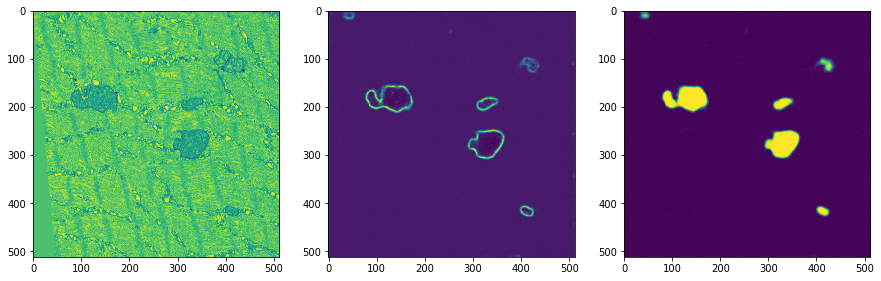

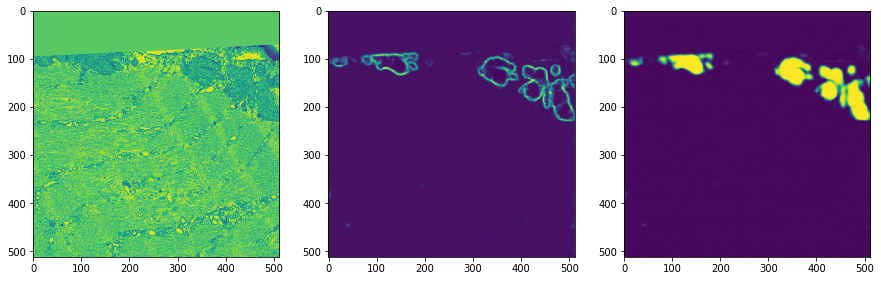

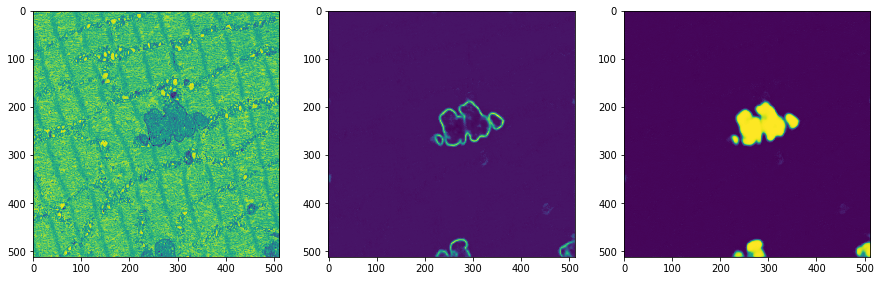

100
Training loss:  0.00900529
(3, 512, 512, 2)
Validation loss:  0.005215116


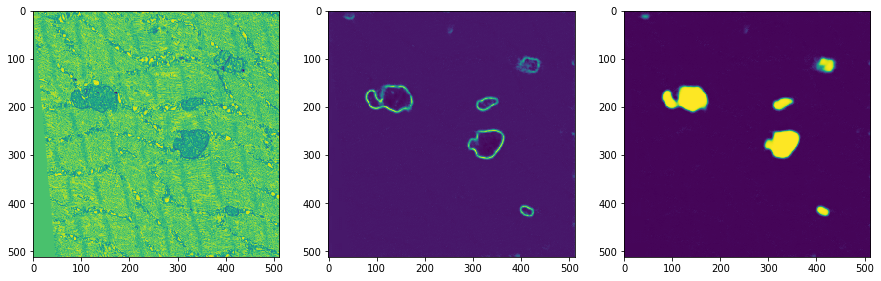

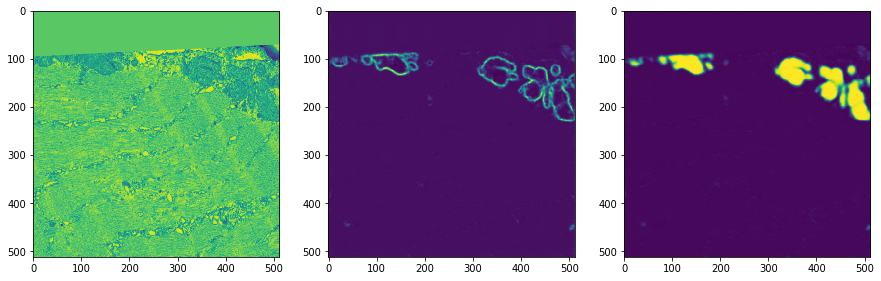

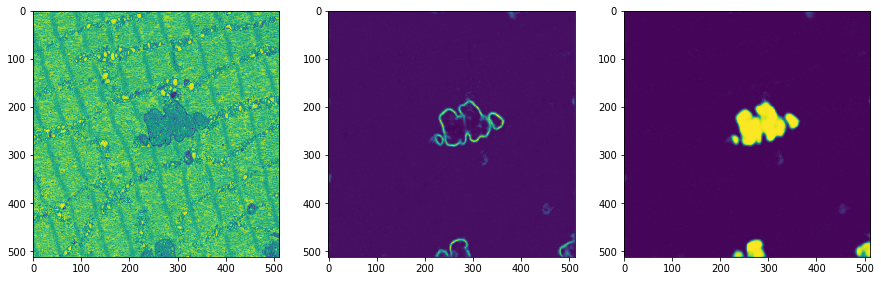

200
Training loss:  0.007782866
(3, 512, 512, 2)
Validation loss:  0.005301018


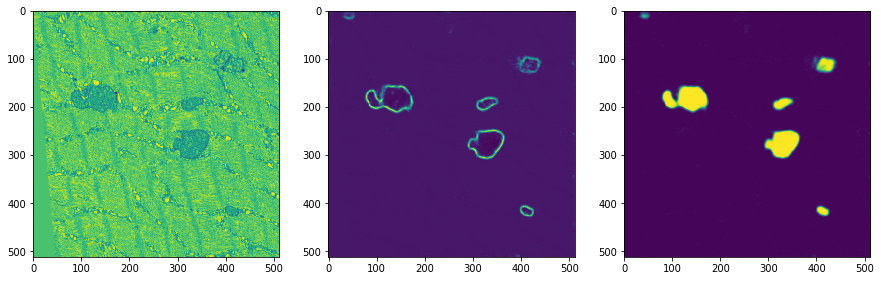

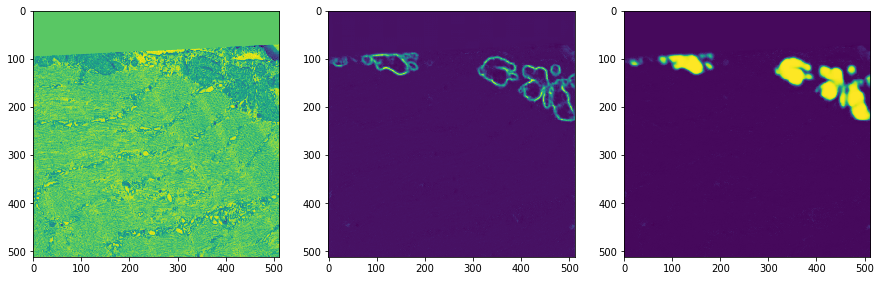

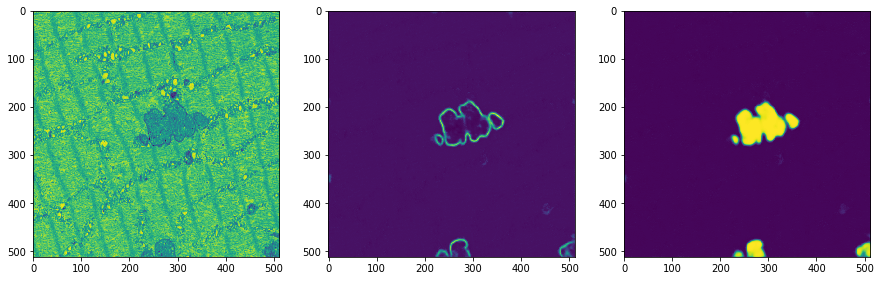

300
Training loss:  0.0063638096
(3, 512, 512, 2)
Validation loss:  0.005252032


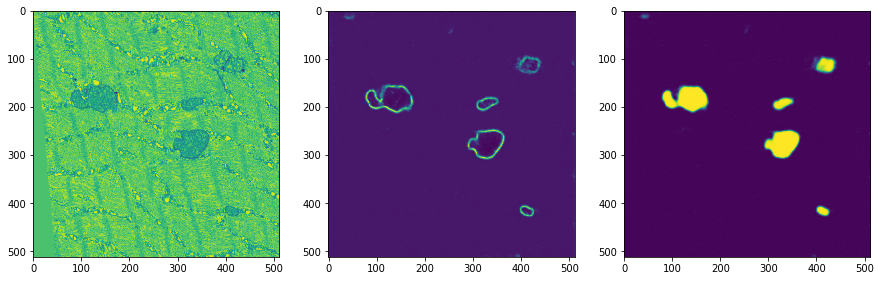

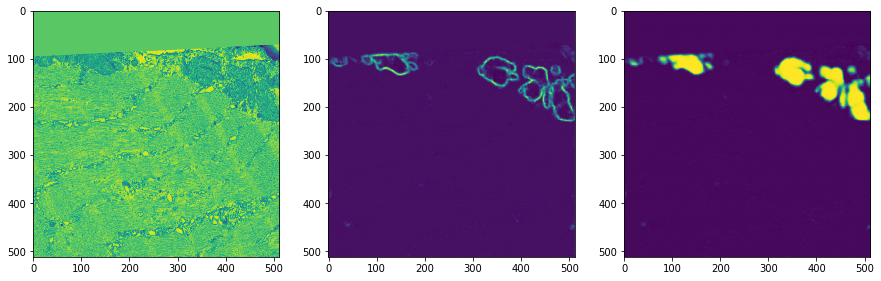

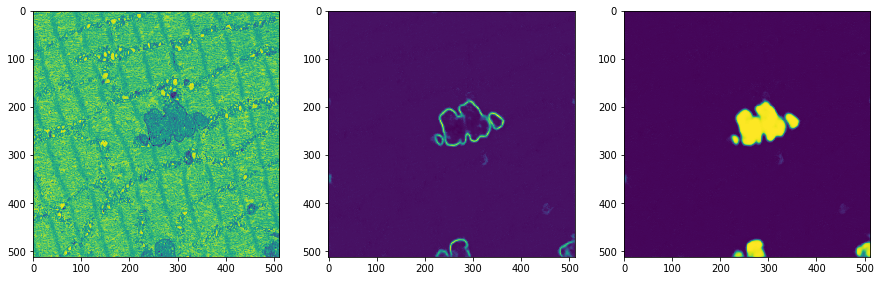

400
Training loss:  0.011437751
(3, 512, 512, 2)
Validation loss:  0.005232986


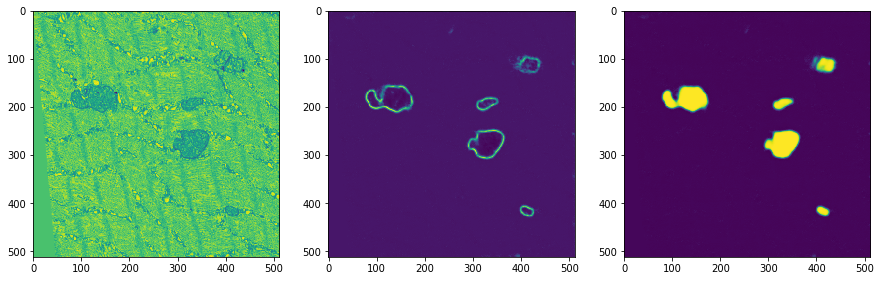

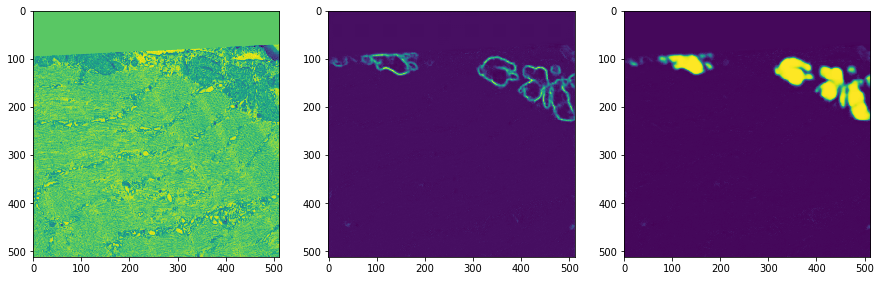

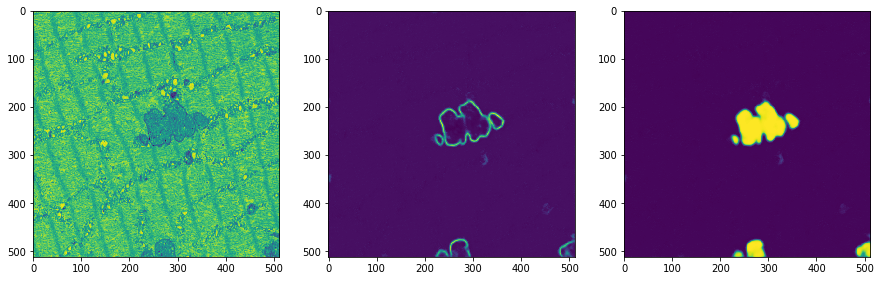

500
Training loss:  0.008659465
(3, 512, 512, 2)
Validation loss:  0.005132097


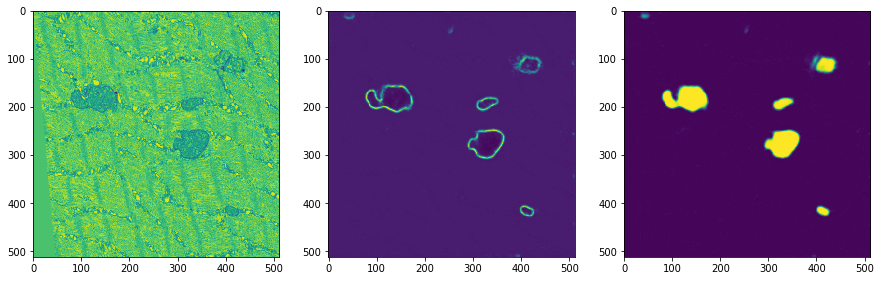

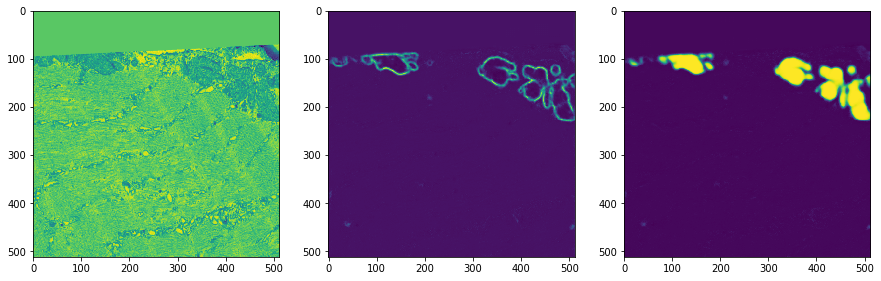

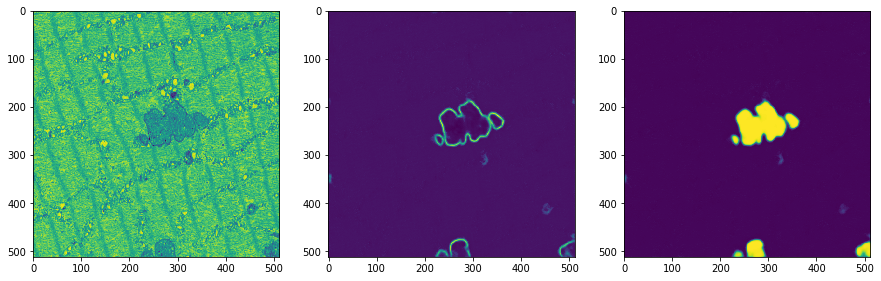

600
Training loss:  0.007433119
(3, 512, 512, 2)
Validation loss:  0.005175729


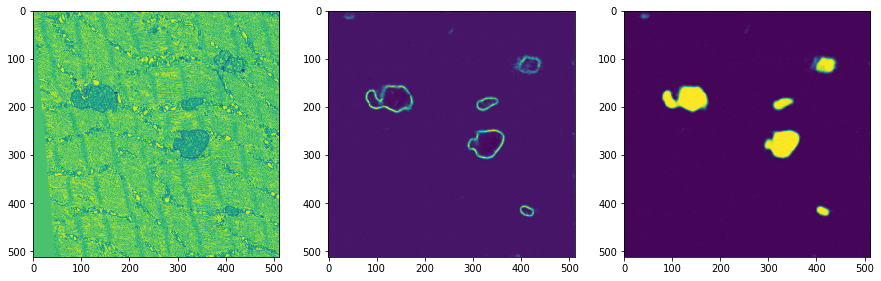

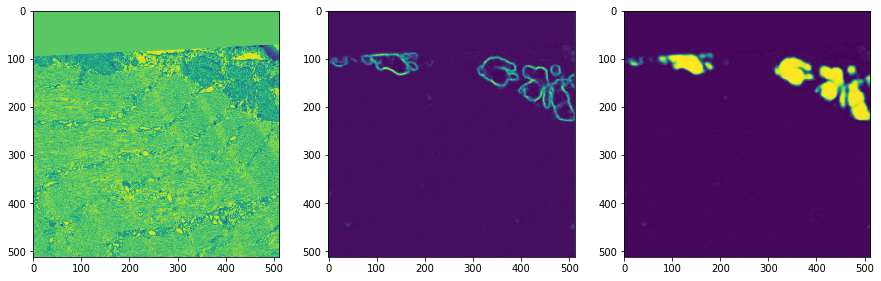

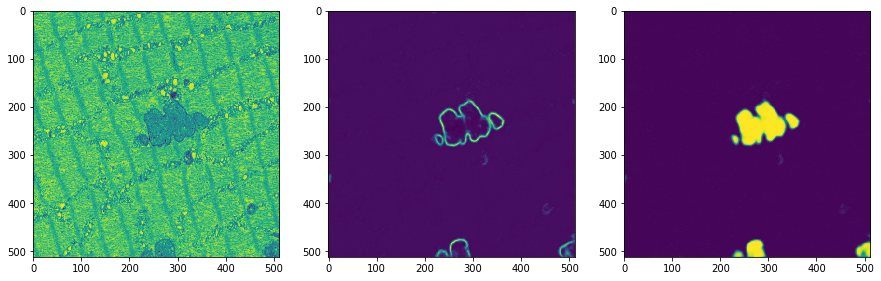

700
Training loss:  0.008370575
(3, 512, 512, 2)
Validation loss:  0.005141972


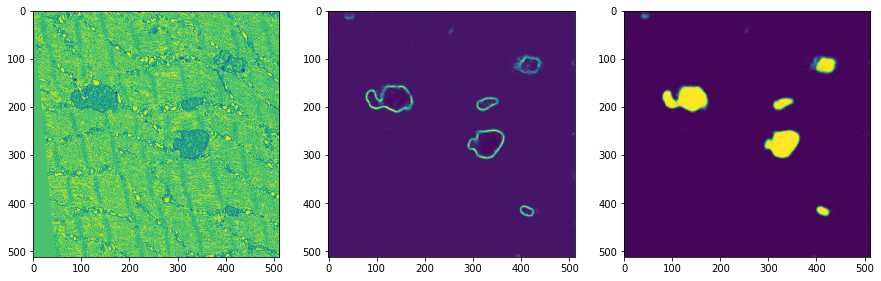

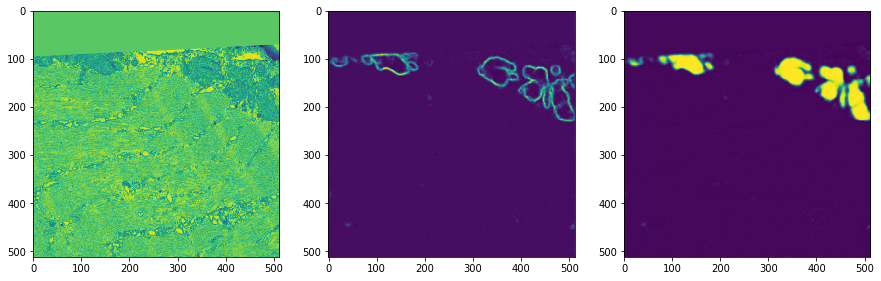

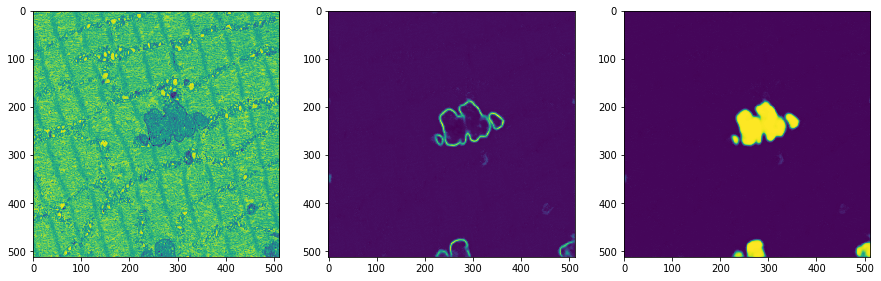

800
Training loss:  0.010153889
(3, 512, 512, 2)
Validation loss:  0.005244376


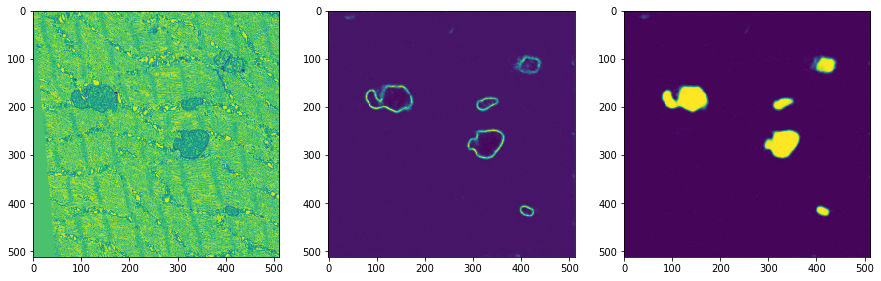

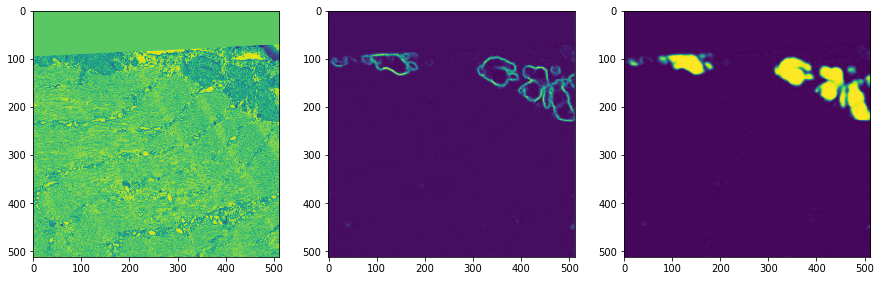

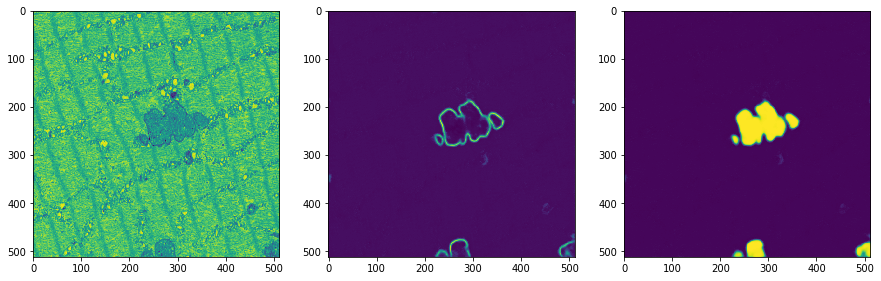

900
Training loss:  0.00825664
(3, 512, 512, 2)
Validation loss:  0.005039207


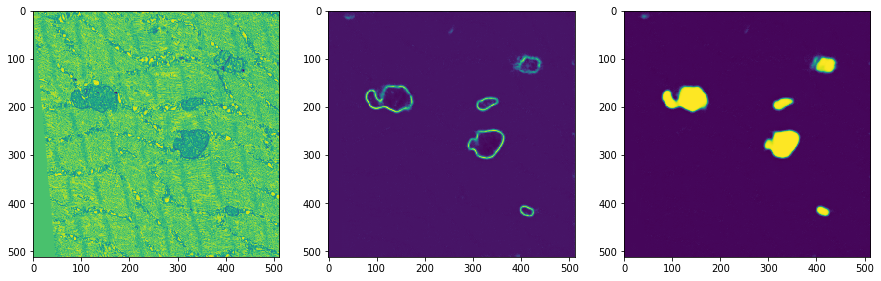

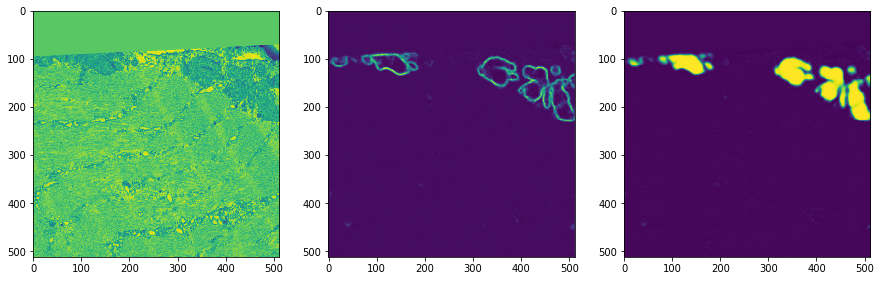

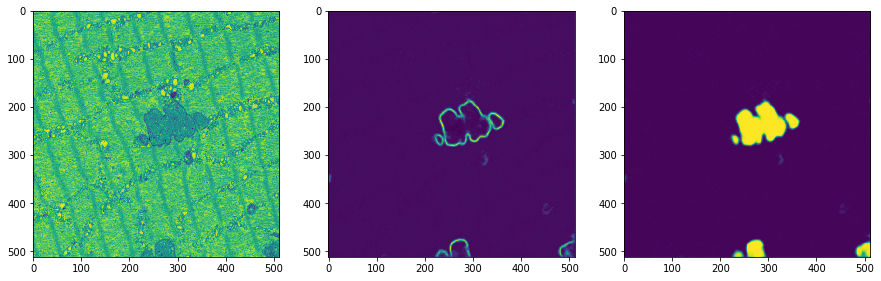

1000
Training loss:  0.009528242
(3, 512, 512, 2)
Validation loss:  0.0051275715


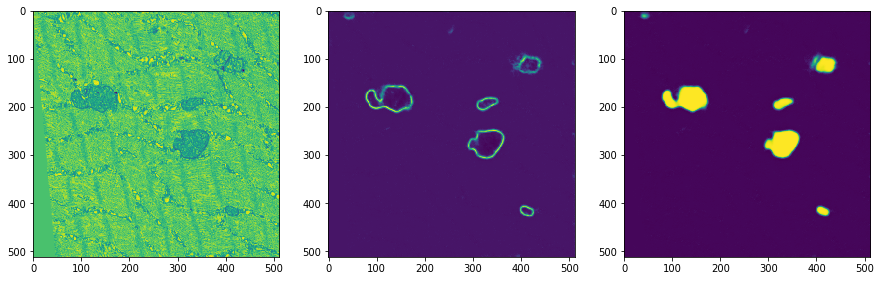

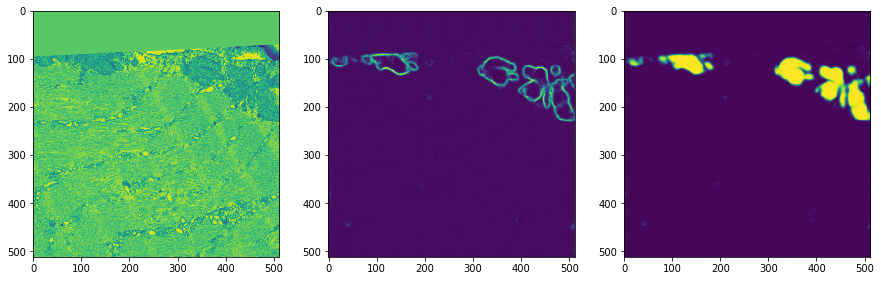

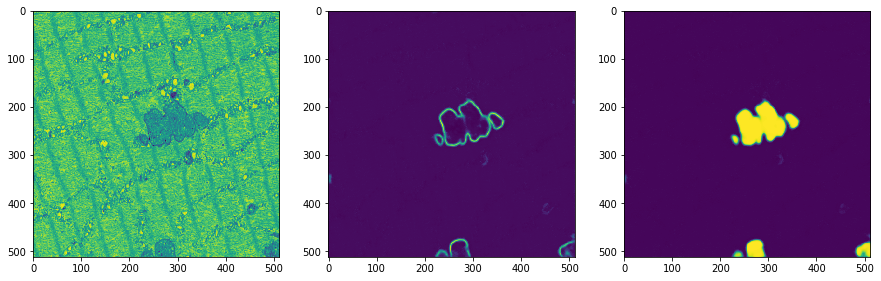

1100
Training loss:  0.0057472433
(3, 512, 512, 2)
Validation loss:  0.005115318


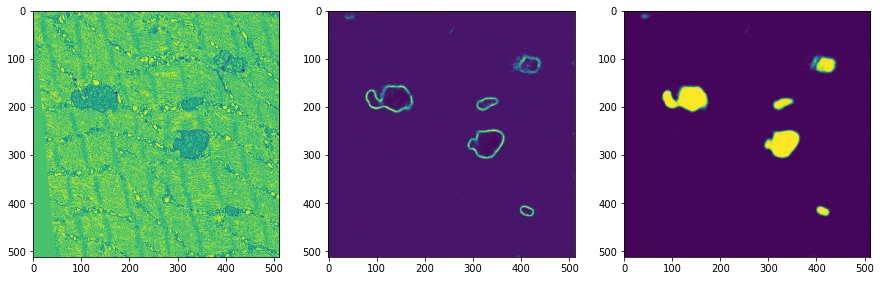

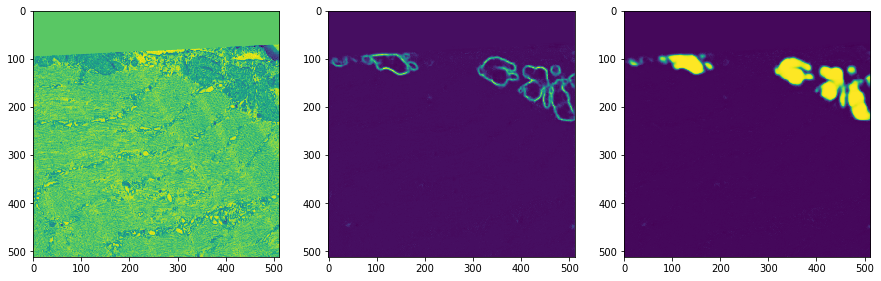

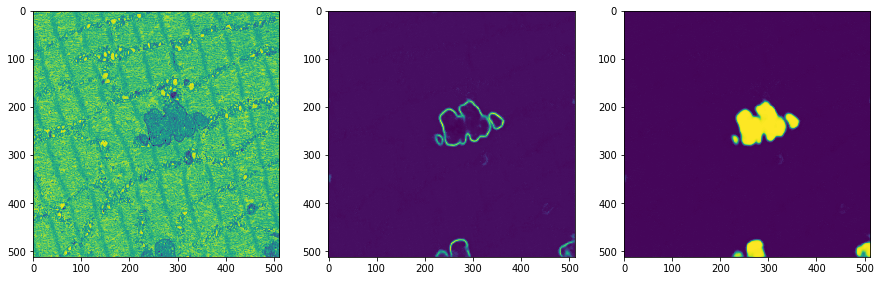

1200
Training loss:  0.0063980236
(3, 512, 512, 2)
Validation loss:  0.0049404763


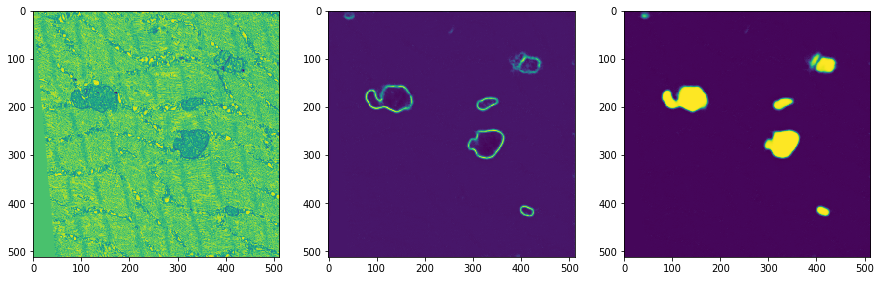

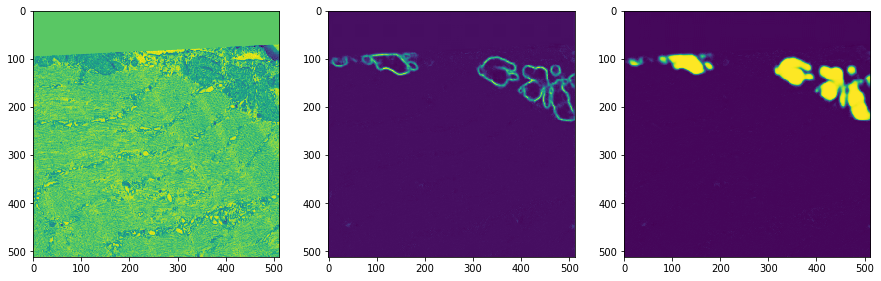

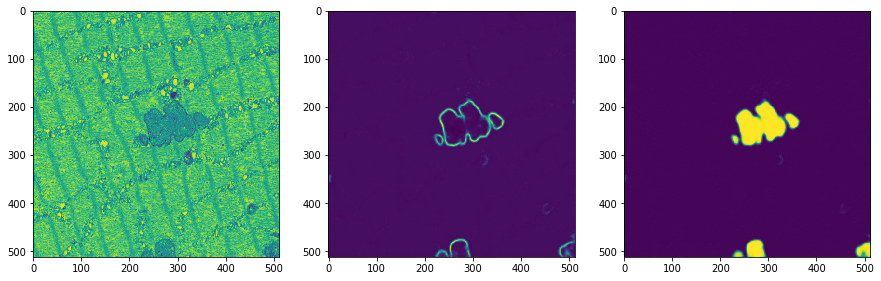

1300
Training loss:  0.009417358
(3, 512, 512, 2)
Validation loss:  0.0048163314


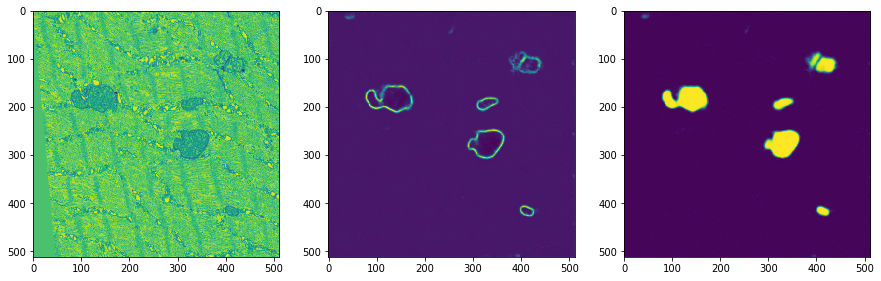

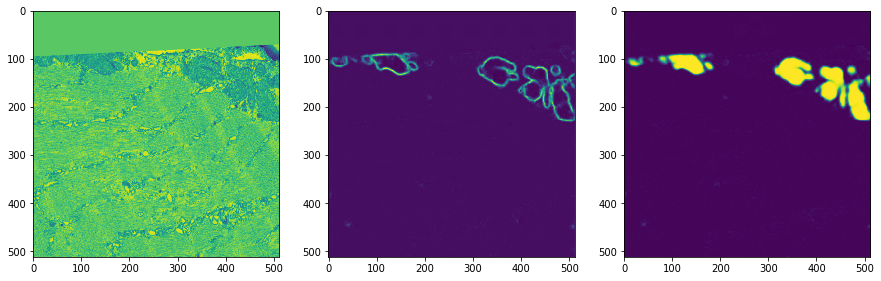

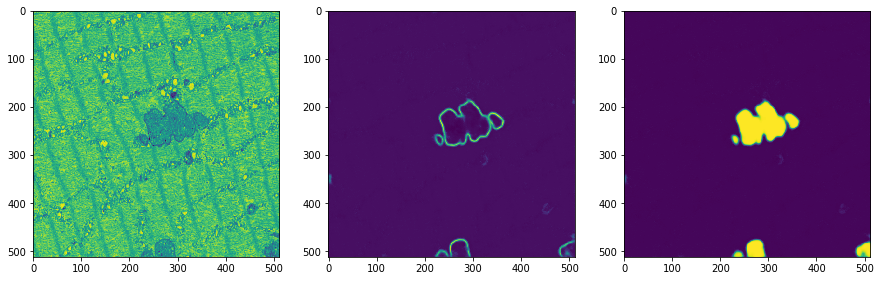

1400
Training loss:  0.008767967
(3, 512, 512, 2)
Validation loss:  0.004719852


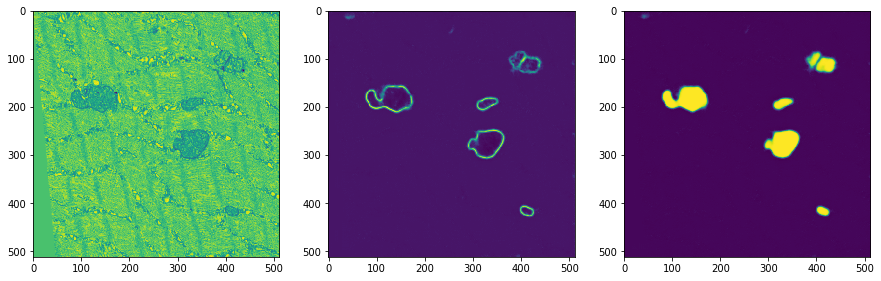

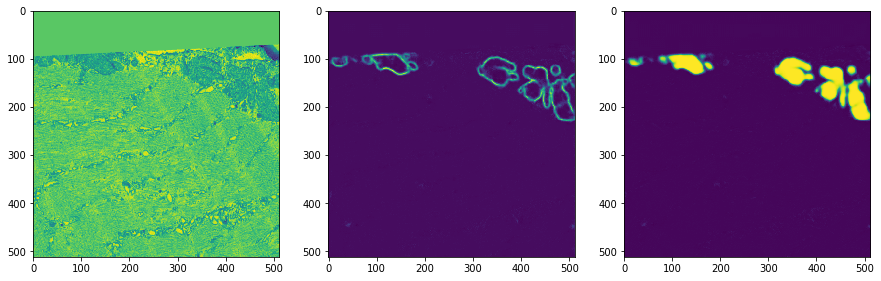

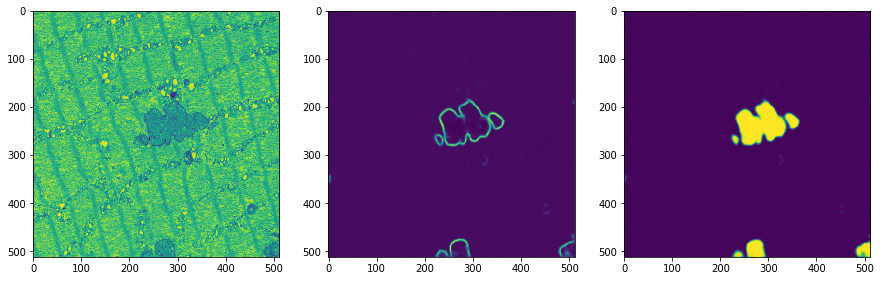

1500
Training loss:  0.008230918
(3, 512, 512, 2)
Validation loss:  0.004679288


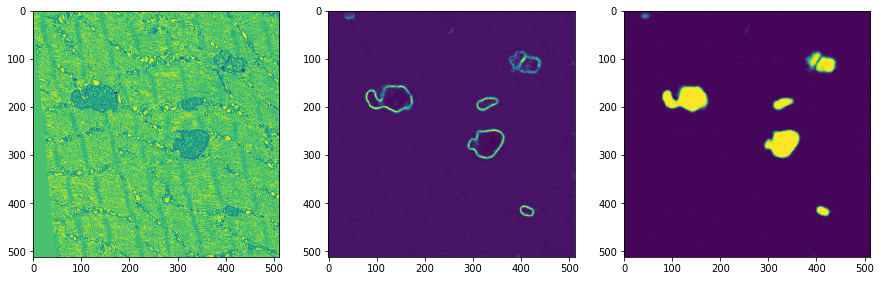

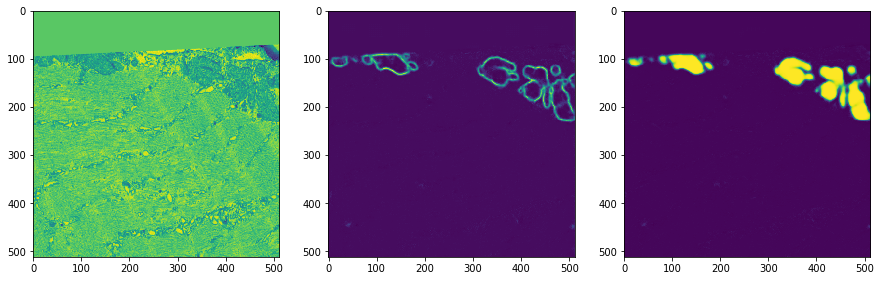

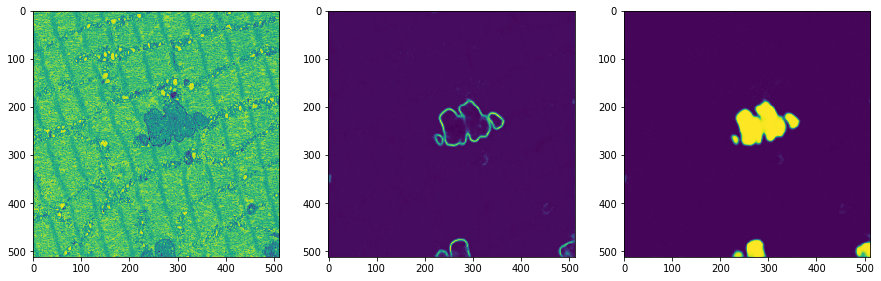

1600
Training loss:  0.007872763
(3, 512, 512, 2)
Validation loss:  0.0046318164


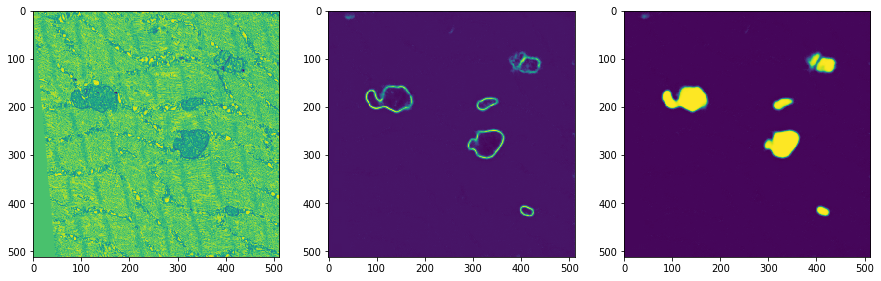

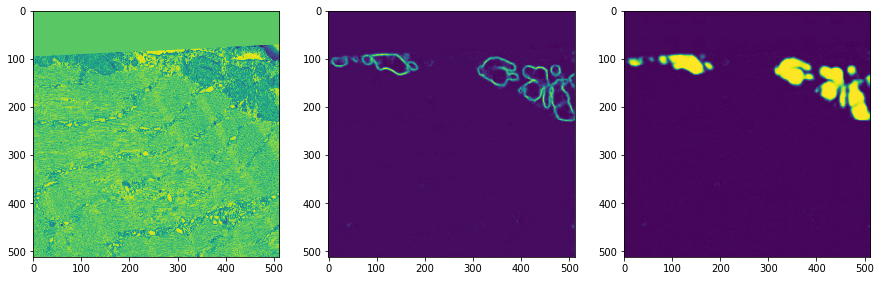

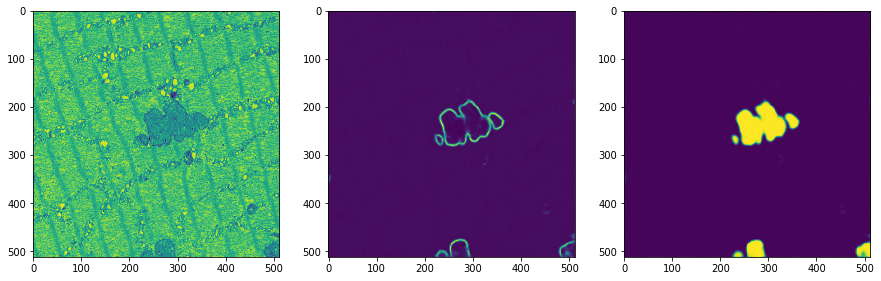

1700
Training loss:  0.007647643
(3, 512, 512, 2)
Validation loss:  0.0045695878


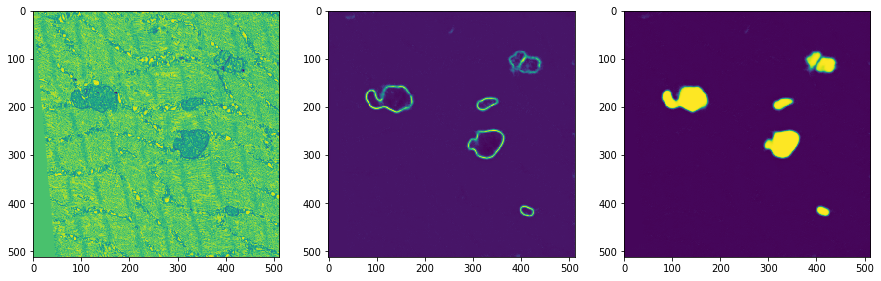

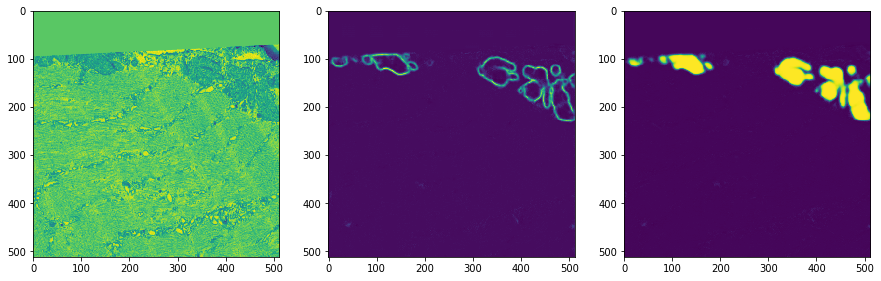

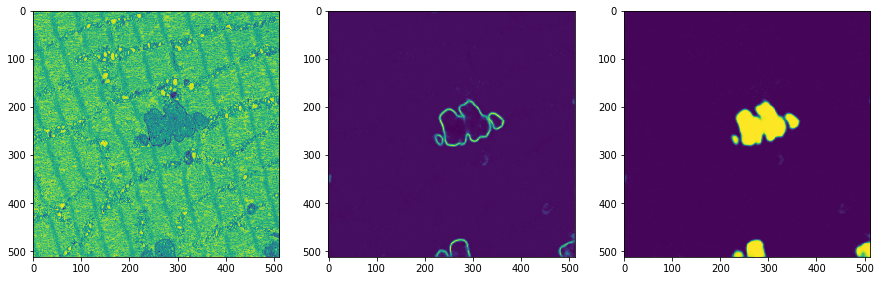

1800
Training loss:  0.005671088
(3, 512, 512, 2)
Validation loss:  0.0045387815


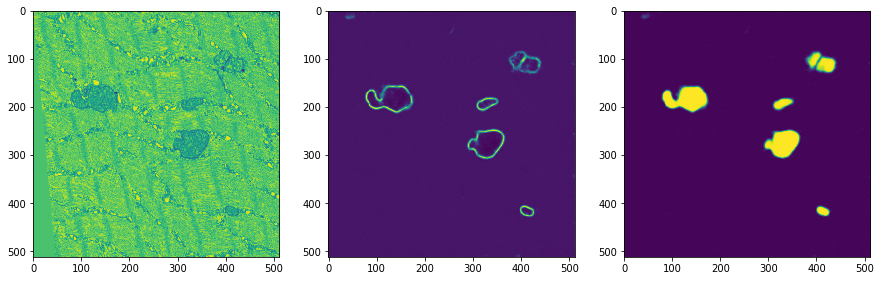

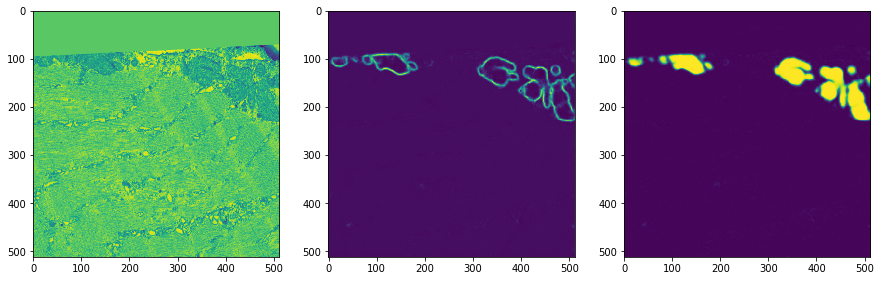

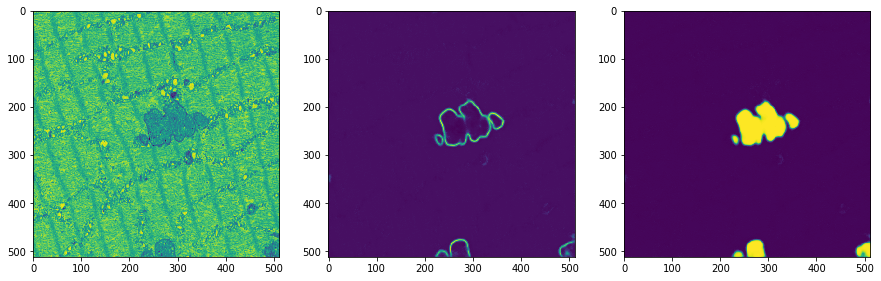

1900
Training loss:  0.0061997413
(3, 512, 512, 2)
Validation loss:  0.0044387146


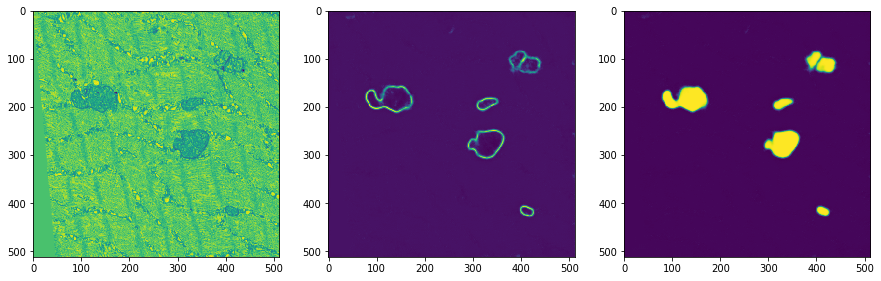

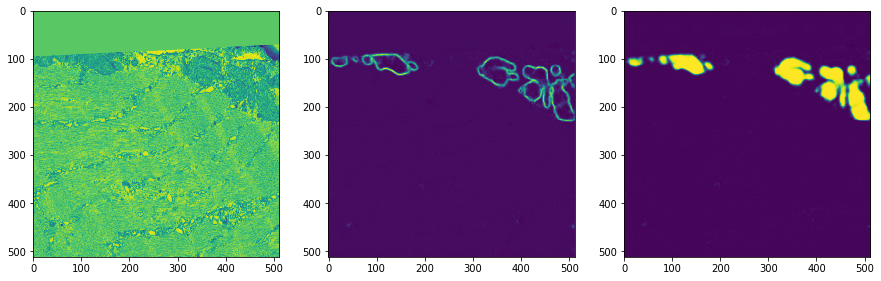

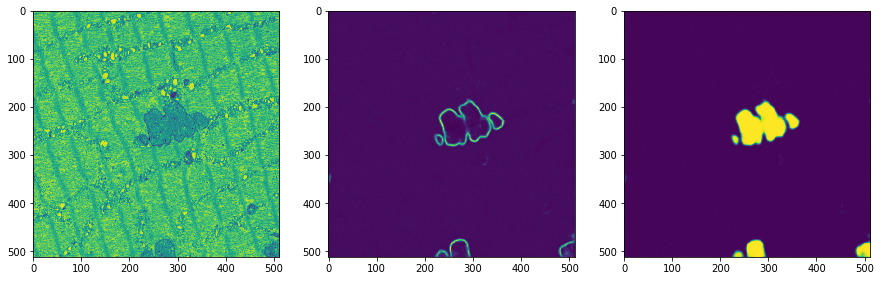

2000
Training loss:  0.005319134
(3, 512, 512, 2)
Validation loss:  0.004447524


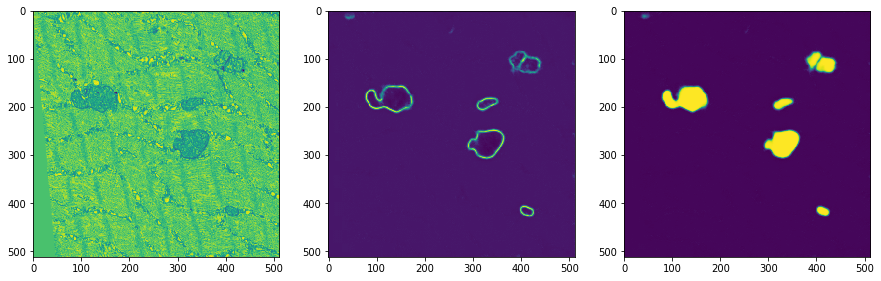

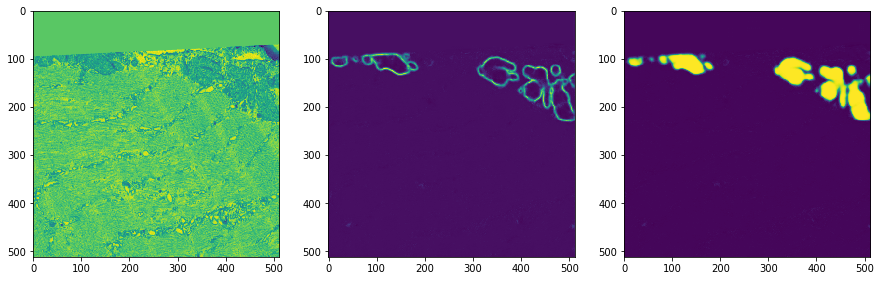

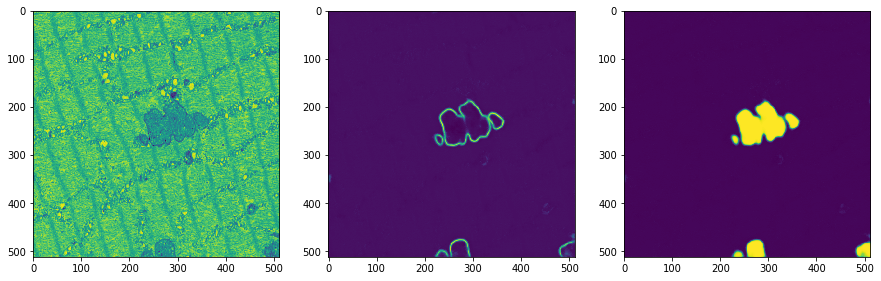

2100
Training loss:  0.0059513003
(3, 512, 512, 2)
Validation loss:  0.004334129


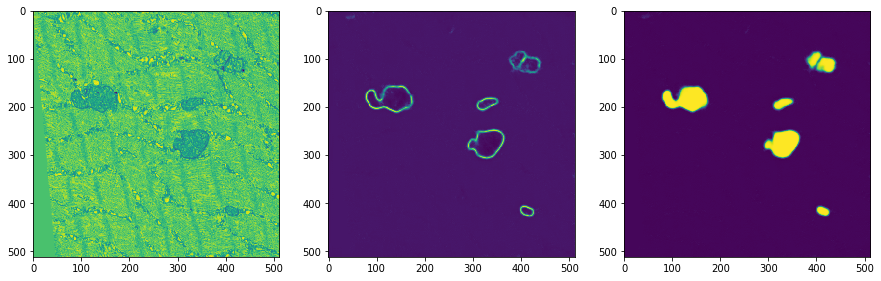

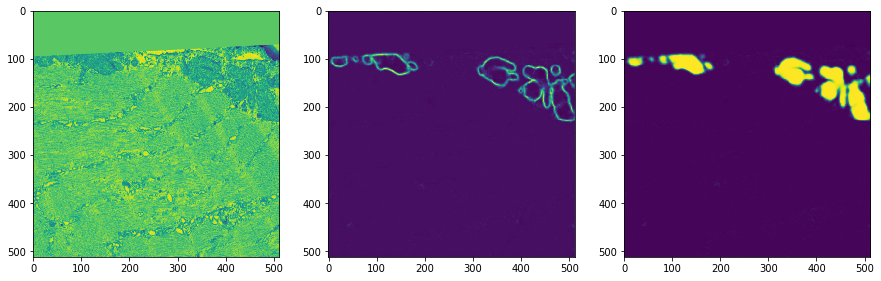

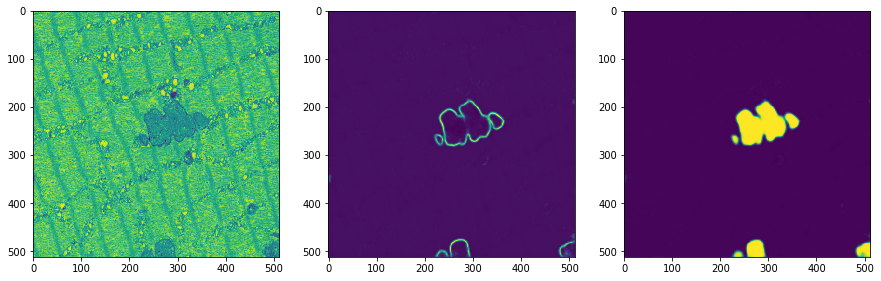

In [57]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
saver = tf.train.Saver(max_to_keep=50)
#train_writer = tf.summary.FileWriter('./logs/1/train ', sess.graph)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.00005, 0.00002, 0.00002, 0.00001]
learning_rate_steps=[500,1500, 2200, 2200]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[25])
        cur_train=train_data[idx,:,:,:]+np.random.uniform(-baseline_noise, baseline_noise, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,3, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses=sess.run([merge, probs, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            if (losses<current_best[1]):
                current_best=[i, losses]
                file=open(data+'Network.txt', 'w')
                file.write(str(base_scaler)+'\n')
                file.write(str(baseline_noise)+'\n')
                file.write(str(x_dim)+'\n')
                file.write(str(mean)+'\n')
                file.write(str(std)+'\n')
                file.write(str(i)+'\n')
                file.write(str(channels)+'\n')
                file.close()
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[ti,:,:,0], results[ti,:,:,0], results[ti,:,:,1])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
    current_step=lrs